<a href="https://colab.research.google.com/github/Acesarsilva/Smartphone_Web_Crawler/blob/main/Classificao_de_paginas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!git clone https://github.com/Acesarsilva/Smartphone_Web_Crawler

In [187]:
import matplotlib.pyplot as plt
from bs4 import BeautifulSoup
import pandas as pd
from lxml import html

In [99]:
list_html = []
inputs = {"/content/html_amazon_earlyblackfriday":0,
            "/content/html_banggood":0,
            "/content/html_banggood_led_digital_display_for_smartphone":0,
            "/content/html_banggood_mechanical_keyboard":0,
            "/content/html_banggood_memory_card":0,
            "/content/html_banggood_smartphone":1,
            "/content/html_banggood_smartphone_poco":1,
            "/content/html_ebay":0,
            "/content/html_ebay_earbuds_bluetooth":0,
            "/content/html_ebay_smartphone_galaxy_a11":1,
            "/content/html_ebay_smartphone_galaxy_g9":1,
            "/content/html_ebay_smartphone_galaxy_s10":1,
            "/content/html_ebay_support_smartphone":0,
            "/content/html_ebay_womens_bags":0}

for path in entradas.keys():
  f1 = open(path, encoding="utf8")     
  soup1 = BeautifulSoup(f1,'lxml')
  list_html.append(str(soup1))
  f1.close()

In [102]:
list_html

['<!DOCTYPE html>\n<html class="a-no-js" data-19ax5a9jf="dingo" lang="en-us"><!-- sp:feature:head-start -->\n<head><script>var aPageStart = (new Date()).getTime();</script><meta charset="utf-8"/>\n<!-- sp:end-feature:head-start -->\n<!-- sp:feature:cs-optimization -->\n<meta content="on" http-equiv="x-dns-prefetch-control"/>\n<link href="https://images-na.ssl-images-amazon.com" rel="dns-prefetch"/>\n<link href="https://m.media-amazon.com" rel="dns-prefetch"/>\n<link href="https://completion.amazon.com" rel="dns-prefetch"/>\n<!-- sp:end-feature:cs-optimization -->\n<!-- sp:feature:aui-assets -->\n<link href="https://images-na.ssl-images-amazon.com/images/I/11EIQ5IGqaL._RC|01ZTHTZObnL.css,41JZEtDv4tL.css,31Y8m1dzTdL.css,013z33uKh2L.css,017DsKjNQJL.css,0131vqwP5UL.css,41EWOOlBJ9L.css,11TIuySqr6L.css,01ElnPiDxWL.css,11bGSgD5pDL.css,01Dm5eKVxwL.css,01IdKcBuAdL.css,01y-XAlI+2L.css,21N4kUH7pxL.css,01oDR3IULNL.css,41CYNGpGlrL.css,01XPHJk60-L.css,114y0SIP+yL.css,21aPhFy+riL.css,11gneA3MtJL.css,

#Processamento de texto e Bag Of Words

In [125]:
import pandas as pd
import tensorflow as tf
pd.set_option('display.max_columns', None)
from sklearn.feature_extraction.text import CountVectorizer

In [135]:
import re
def preprocess_text(text):
    text = text.lower()
    text = re.sub(r'\d+', '', text)
    #text = re.match("[A-Za-z]*$", string)
    return text

In [145]:
text_bow = CountVectorizer(preprocessor = preprocess_text,
                           analyzer = 'word',
                           lowercase=True,
                           strip_accents='ascii',
                           ngram_range=(1,1), #to use bigrams ngram_range=(2,2)
                           stop_words='english')

#Fazendo as transformações nos arquivos HTML escolhidos
data = text_bow.fit_transform(list_html)
 
#Dataframe
df_bow = pd.DataFrame(data.toarray(),columns=text_bow.get_feature_names())
df_bow.head(20)

,__bgqueue,__isempty,__loadermetadata,__merchandising,__noname__,__nspid,__nsptags,__runtime,__search,_a,_ads_napkin_response,_armrs,_aspectname,_bfcm_widget_x_color_block,_blank,_bo_cnt_id,_bo_trbr_id,_cb_,_cnt,_context,_cr,_d,_day,_dbmposition,_dc,_dmd,_electronics,_encoding,_erricon,_errmsg,_exsp,_fcid,_fetch_merch_response,_fmjpg_,_from,_fsrp,_ftm,_g,_ghz,_gno_p_foot,_h,_hour,_hours,_i,_incbid,_ipg,_items,_itm,_jgr,_m,_mod,_mod_merch,_mod_vim,_msg,_mtb,_namespace,_navbar,_navbarspriteurl,_nkw,_np,_oct,_opn_ocb_layer,_opn_onload_ocb_layer,_opn_onload_pb_layer,_opn_onload_powb_layer,_opn_pb_layer,_opn_powb_layer,_parent,_pgn,_plsubtinp,_plsubttq,_presetid,_qtyerr_,_rc,_rdanddc_store_arr,_replay,_reserve,_row,_rtop,_rvwlnk,_s,_sacat,_sasi,_seedid,_shims,_soffid,_sofftype,_sop,_sourcename,_sp,_submit_cartbtn,_sy_,_tq,_trkparms,_trksid,_ts,_type,_udhi,_udlo,_ul,_us_footer_drive,_v_,_value,_vc,_wbind,aa,aaa,aaaaaaaaaa,aaaccd,aaad,aaaedffc,aaaf,aaaoswiefhwi,aaba,aabababefafbcbbccbabddbdfcdddabeaaadadedcaddfddcfeffb,aabc,aabcc,aac,aacb,aad,aaddefaecdbdaacfebbdaaefffff,aae,aaea,aaebe,aaefbd,aaf,aafcaed,aaffe,aafkykeyquuzywolhgcsanmdpfryyeqkb,aakotwzynws,aaoswggxhgdhk,aaoswgpxacdp,aaoswkyhhxng,aaoswqjlhcpff,aaoswqmnhzrce,aaoswvhstvy,aapi,aapicsrftoken,aapigetdealslist,aaqagaaacaaimmedmkajplnexflpgotinhaxh,aaqagaaacahmfushewrwjgqqzi,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssime,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimebxsadlkontpmcbopistqnzwmgkuwmgjzmtldyjvwsyjpipezaezqlckpylyupgrcfucsnksrrkwvwlsjvtqsu,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimec,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeckjmo,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimemjbbkphqpiixtlimeprixmxorggbxrz,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimewfbpskvhxhwbtbcykreiydyoniefgdvxmqvfnigbvrkxww,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeyqieltxsdmaerullmthvchuqwghuyhbzjlailevlsazcoigzouhbavmei,aaqagaaacehmfushewrwjgqqzi,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssime,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeunupesqyzmuwikmdrccmqjc,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeunupesqyzmuwikmdrdgzykqwevvgssomcueafpnjigsfjf,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimew,aaqagaaackpyenmhp,aaqagaaacmjjravt,aaqagaaacopyenmhp,aavw,aawaaoswrklvympo,aazkaatt,ab,ab_homepage_rr,ab_version,aba,abaaaa,abab,abacf,abaf,abaixo,abajures,abb,abcaadbeefbfaddacadfffaeacbddcadcfeafadafabacbfefbfdfaddebbd,abcffb,abdceecbcceddbefafefdddbbfcdafbafdcedfcacffdffbebfcdccce,abdecaaaffedcebdefcffecfcfedaeefbbbedfdadcfcdccfedbccbcdad,abe,abebooks,abedbb,abeeeaebdbabbcdcdbdafdbdfbacccafdbcedbdacbebccaffffdccdcf,abefb,abelement,aberration,aberta,abf,abfaa,abfbmlousf,abfbmpnhpf,abfbmwnsef,abid,abincounterenabled,abletopersist,aboaaoswfuzhri,abonjbnowlvuetvxjqx,about_this_item,aboutamazon,aboutbanggood,aboutme,abovenavinjection,abovenavinjectioncss,abovenavinjectionjs,abovethefold,abrand,abre,abs,absolute,absorbing,ac,aca,acabamento,academia,acae,acampamento,acb,acbac,acbbbdd,acbodgzpkqducditlugvgieckgsemkozqpa,acc,accaadb,accdfbcaaf,acceleratedurationinmins,acceleration,accelerationbase,accelerationratio,accelerometer,accept,access,accesseddate,accessibility,accessibilitytext,accessible,accessiblity,accessories,accessory,accessorylabel,accordance,according,accordingly,accordion,account,accountid,accountlist,accountlistcontent,accountlistflyoutredesign,accountlistredirectfix,accounttext,accrd,acd,ace,acedac,aceita,aceitas,aceitação,acessar,acesso,acessorios,acessórios,acf,acfcbaadafdfebdccffceefeefebaacaaebcfccaadbefafaddeeaddffbac,acfcbfbabacbebaabffcdbaacffdcedeecfefbcdcaaacddefaafeecceebdcde,acfeacbcb,acff,achar,acharam,achunktimes,acima,acionamento,acionistas,acolchoada,acolor,acomfo,acordo,acpt,acqaqeqlzpftoijpzwnfcjvefqutyt,acsux,acsuxwidget,acswidget,acswidgetassets,act,action,action_source,actionable,actionbu

In [146]:
len(df_bow.columns)

14787

In [147]:
df_bow[['smartphone']]

,smartphone
0,0
1,2
2,0
3,0
4,0
5,86
6,90
7,8
8,0
9,3


In [148]:
df_bow['coluna_alvo'] = [row for row in inputs.values()]
df_bow.head(20)

,__bgqueue,__isempty,__loadermetadata,__merchandising,__noname__,__nspid,__nsptags,__runtime,__search,_a,_ads_napkin_response,_armrs,_aspectname,_bfcm_widget_x_color_block,_blank,_bo_cnt_id,_bo_trbr_id,_cb_,_cnt,_context,_cr,_d,_day,_dbmposition,_dc,_dmd,_electronics,_encoding,_erricon,_errmsg,_exsp,_fcid,_fetch_merch_response,_fmjpg_,_from,_fsrp,_ftm,_g,_ghz,_gno_p_foot,_h,_hour,_hours,_i,_incbid,_ipg,_items,_itm,_jgr,_m,_mod,_mod_merch,_mod_vim,_msg,_mtb,_namespace,_navbar,_navbarspriteurl,_nkw,_np,_oct,_opn_ocb_layer,_opn_onload_ocb_layer,_opn_onload_pb_layer,_opn_onload_powb_layer,_opn_pb_layer,_opn_powb_layer,_parent,_pgn,_plsubtinp,_plsubttq,_presetid,_qtyerr_,_rc,_rdanddc_store_arr,_replay,_reserve,_row,_rtop,_rvwlnk,_s,_sacat,_sasi,_seedid,_shims,_soffid,_sofftype,_sop,_sourcename,_sp,_submit_cartbtn,_sy_,_tq,_trkparms,_trksid,_ts,_type,_udhi,_udlo,_ul,_us_footer_drive,_v_,_value,_vc,_wbind,aa,aaa,aaaaaaaaaa,aaaccd,aaad,aaaedffc,aaaf,aaaoswiefhwi,aaba,aabababefafbcbbccbabddbdfcdddabeaaadadedcaddfddcfeffb,aabc,aabcc,aac,aacb,aad,aaddefaecdbdaacfebbdaaefffff,aae,aaea,aaebe,aaefbd,aaf,aafcaed,aaffe,aafkykeyquuzywolhgcsanmdpfryyeqkb,aakotwzynws,aaoswggxhgdhk,aaoswgpxacdp,aaoswkyhhxng,aaoswqjlhcpff,aaoswqmnhzrce,aaoswvhstvy,aapi,aapicsrftoken,aapigetdealslist,aaqagaaacaaimmedmkajplnexflpgotinhaxh,aaqagaaacahmfushewrwjgqqzi,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssime,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimebxsadlkontpmcbopistqnzwmgkuwmgjzmtldyjvwsyjpipezaezqlckpylyupgrcfucsnksrrkwvwlsjvtqsu,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimec,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeckjmo,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimemjbbkphqpiixtlimeprixmxorggbxrz,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimewfbpskvhxhwbtbcykreiydyoniefgdvxmqvfnigbvrkxww,aaqagaaacaofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeyqieltxsdmaerullmthvchuqwghuyhbzjlailevlsazcoigzouhbavmei,aaqagaaacehmfushewrwjgqqzi,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssime,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeunupesqyzmuwikmdrccmqjc,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimeunupesqyzmuwikmdrdgzykqwevvgssomcueafpnjigsfjf,aaqagaaaceofyzdlwoysswizxsztjjnqcfkmnzlqpnxfbpfboetszxllssimew,aaqagaaackpyenmhp,aaqagaaacmjjravt,aaqagaaacopyenmhp,aavw,aawaaoswrklvympo,aazkaatt,ab,ab_homepage_rr,ab_version,aba,abaaaa,abab,abacf,abaf,abaixo,abajures,abb,abcaadbeefbfaddacadfffaeacbddcadcfeafadafabacbfefbfdfaddebbd,abcffb,abdceecbcceddbefafefdddbbfcdafbafdcedfcacffdffbebfcdccce,abdecaaaffedcebdefcffecfcfedaeefbbbedfdadcfcdccfedbccbcdad,abe,abebooks,abedbb,abeeeaebdbabbcdcdbdafdbdfbacccafdbcedbdacbebccaffffdccdcf,abefb,abelement,aberration,aberta,abf,abfaa,abfbmlousf,abfbmpnhpf,abfbmwnsef,abid,abincounterenabled,abletopersist,aboaaoswfuzhri,abonjbnowlvuetvxjqx,about_this_item,aboutamazon,aboutbanggood,aboutme,abovenavinjection,abovenavinjectioncss,abovenavinjectionjs,abovethefold,abrand,abre,abs,absolute,absorbing,ac,aca,acabamento,academia,acae,acampamento,acb,acbac,acbbbdd,acbodgzpkqducditlugvgieckgsemkozqpa,acc,accaadb,accdfbcaaf,acceleratedurationinmins,acceleration,accelerationbase,accelerationratio,accelerometer,accept,access,accesseddate,accessibility,accessibilitytext,accessible,accessiblity,accessories,accessory,accessorylabel,accordance,according,accordingly,accordion,account,accountid,accountlist,accountlistcontent,accountlistflyoutredesign,accountlistredirectfix,accounttext,accrd,acd,ace,acedac,aceita,aceitas,aceitação,acessar,acesso,acessorios,acessórios,acf,acfcbaadafdfebdccffceefeefebaacaaebcfccaadbefafaddeeaddffbac,acfcbfbabacbebaabffcdbaacffdcedeecfefbcdcaaacddefaafeecceebdcde,acfeacbcb,acff,achar,acharam,achunktimes,acima,acionamento,acionistas,acolchoada,acolor,acomfo,acordo,acpt,acqaqeqlzpftoijpzwnfcjvefqutyt,acsux,acsuxwidget,acswidget,acswidgetassets,act,action,action_source,actionable,actionbu

In [149]:
df_bow[['smartphone','coluna_alvo']]

,smartphone,coluna_alvo
0,0,0
1,2,0
2,0,0
3,0,0
4,0,0
5,86,1
6,90,1
7,8,0
8,0,0
9,3,1


# Etapa 2: Feature Selection

In [163]:
#Dataframe com a selação de variavies (Por enquanto, com uma seleção ALEATORIA)
df_bow.iloc[0:20,1000:2000]

austrália  authentic  authenticationtype  authenticity  authitem  author  \
0           0          0                   1             0         0       0   
1           0          0                   0             0         3       1   
2           0          0                   0             0         3       1   
3           0          0                   0             0         3       1   
4           0          0                   0             0         3       1   
5           0          0                   0             0         3       1   
6           0          0                   0             0         3       1   
7           0          0                   0             0         0       0   
8           1          0                   0             0         0       0   
9           2          0                   0             0         0      15   
10          2          0                   0            25         0       0   
11          2          0                   0             0         0       0   
12          2          0                   0             0         0       0   
13          0          8                   0             0         0       0   

    authorization  authorsuggestiontext  auto  auto_refresh_disable_btn_svc  \
0               0                     3     8                             0   
1               0                     0     1                             0   
2               0                     0     4                             0   
3               0                     0     4                             0   
4               0                     0     4                             0   
5               0                     0     4                             0   
6               0                     0     4                             0   
7               0                     0     6                             0   
8               1                     0     3                             0   
9               1                     0     3                             1   
10              1                     0     5                             0   
11              1                     0     5                             0   
12              1                     0     3                             0   
13              0                     0     0                             0   

    auto_refresh_svc  auto_tracking_widget  autocapitalize  autocars  \
0                  0                     0               0         0   
1                  0                     0               0         0   
2                  0                     0               0         0   
3                  0                     0               0         0   
4                  0                     0               0         0   
5                  0                     0               0         0   
6                  0                     0               0         0   
7                  0                     1               1         0   
8                  1                     1               1         1   
9                  6                     1               1         1   
10                 1                     1               1         1   
11                 1                     1               1         1   
12                 1                     1               1         1   
13                 0                     1               1         0   

    autocomplete  autocomplete_js  autocorrect  autofocus  automation  \
0              5                0            0          4           0   
1              4                0            0          0           0   
2              8                0            0          0           0   
3              8                0            0          0           0   
4              8                0            0          0           0   
5              8                0            0          0           0   
6              8         

#Iniciando estudo com os modelos de Machine Learning propostos
  - Naïve bayes,
  - Decision tree (J48),
  - SVM (SMO),
  - Logistic regression (logistic),
  - Multilayer perceptron 

In [192]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,plot_confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn import metrics

In [193]:
data_select = df_bow.iloc[0:20,1000:2000]

In [194]:
data_select

austrália  authentic  authenticationtype  authenticity  authitem  author  \
0           0          0                   1             0         0       0   
1           0          0                   0             0         3       1   
2           0          0                   0             0         3       1   
3           0          0                   0             0         3       1   
4           0          0                   0             0         3       1   
5           0          0                   0             0         3       1   
6           0          0                   0             0         3       1   
7           0          0                   0             0         0       0   
8           1          0                   0             0         0       0   
9           2          0                   0             0         0      15   
10          2          0                   0            25         0       0   
11          2          0                   0             0         0       0   
12          2          0                   0             0         0       0   
13          0          8                   0             0         0       0   

    authorization  authorsuggestiontext  auto  auto_refresh_disable_btn_svc  \
0               0                     3     8                             0   
1               0                     0     1                             0   
2               0                     0     4                             0   
3               0                     0     4                             0   
4               0                     0     4                             0   
5               0                     0     4                             0   
6               0                     0     4                             0   
7               0                     0     6                             0   
8               1                     0     3                             0   
9               1                     0     3                             1   
10              1                     0     5                             0   
11              1                     0     5                             0   
12              1                     0     3                             0   
13              0                     0     0                             0   

    auto_refresh_svc  auto_tracking_widget  autocapitalize  autocars  \
0                  0                     0               0         0   
1                  0                     0               0         0   
2                  0                     0               0         0   
3                  0                     0               0         0   
4                  0                     0               0         0   
5                  0                     0               0         0   
6                  0                     0               0         0   
7                  0                     1               1         0   
8                  1                     1               1         1   
9                  6                     1               1         1   
10                 1                     1               1         1   
11                 1                     1               1         1   
12                 1                     1               1         1   
13                 0                     1               1         0   

    autocomplete  autocomplete_js  autocorrect  autofocus  automation  \
0              5                0            0          4           0   
1              4                0            0          0           0   
2              8                0            0          0           0   
3              8                0            0          0           0   
4              8                0            0          0           0   
5              8                0            0          0           0   
6              8         

In [195]:
X = data_select
y = df_bow[['coluna_alvo']]
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.75,test_size=0.25,random_state=42)

In [196]:
y.value_counts()

coluna_alvo
0              9
1              5
dtype: int64

In [197]:
y_train.value_counts()

coluna_alvo
0              7
1              3
dtype: int64

In [198]:
y_test.value_counts()

coluna_alvo
1              2
0              2
dtype: int64

In [205]:
def def_metrics(test,pred):
    print(confusion_matrix(test,pred))
    print(classification_report(test,pred))
    print(accuracy_score(test,pred))

In [206]:
def confusion_matrix(model,x_test,y_test):
    matrix = plot_confusion_matrix(model,x_test,y_test)
    matrix.ax_.set_title('Confusion Matrix ', color ='black')
    
    plt.xlabel('PREDICTED LABEL',color='black')
    plt.ylabel('TRUE LABEL',color='black')
    
    plt.gcf().axes[0].tick_params(colors='black')
    plt.gcf().axes[1].tick_params(colors='black')
    plt.gcf().set_size_inches(10,6)
    plt.show()

## Decision Tree

In [207]:
from sklearn.tree import DecisionTreeClassifier

In [208]:
model_decision_tree = DecisionTreeClassifier()

model_decision_tree = model_decision_tree.fit(X_train,y_train)

y_pred = model_decision_tree.predict(X_test)

In [209]:
#print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
def_metrics(y_test,y_pred)

TypeError: ignored

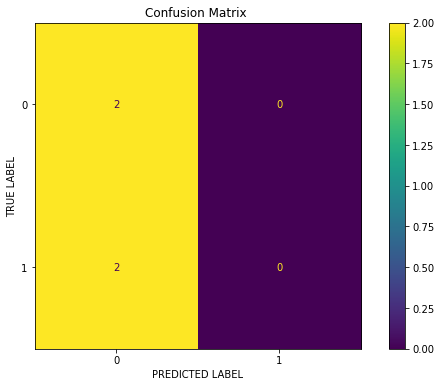

In [204]:
confusion_matrix(model_decision_tree,X_test,y_test)

##Naïve bayes

In [210]:
from sklearn.naive_bayes import GaussianNB

In [212]:
model_naive_bayes = GaussianNB()

y_pred_nb = model_naive_bayes.fit(X_train, y_train).predict(X_test)

/usr/local/lib/python3.7/dist-packages/sklearn/naive_bayes.py:206: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [215]:
print("Number of mislabeled points out of a total %d points : %d" % (X_test.shape[0], (y_test != y_pred_nb).sum()))

ValueError: ignored

In [216]:
def_metrics(y_test,y_pred)

TypeError: ignored

##Linear SVM

In [223]:
from sklearn.svm import LinearSVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [225]:
model_svm = make_pipeline(StandardScaler(),
                     LinearSVC(random_state=0, tol=1e-5))
model_svm.fit(X_test, y_test)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearsvc', LinearSVC(random_state=0, tol=1e-05))])

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


NameError: ignored

##Logistic Regression

In [226]:
from sklearn.linear_model import LogisticRegression

In [227]:
model_logistic_regression = LogisticRegression(random_state=0).fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [229]:
model_logistic_regression.score(X_test, y_test)

0.75

##Multlayer Perceptron

In [231]:
from sklearn.neural_network import MLPClassifier

In [232]:
model_perceptron = MLPClassifier(random_state=1, max_iter=300).fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:934: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [233]:
model_perceptron.predict_proba(X_test[:1])

array([[4.58394486e-04, 9.99541606e-01]])

In [234]:
model_perceptron.score(X_test, y_test)

0.75

In [ ]:
>>> from sklearn.neural_network import MLPClassifier
>>> from sklearn.datasets import make_classification
>>> from sklearn.model_selection import train_test_split
>>> X, y = make_classification(n_samples=100, random_state=1)
>>> X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y,
...                                                     random_state=1)
>>> clf = MLPClassifier(random_state=1, max_iter=300).fit(X_train, y_train)
>>> clf.predict_proba(X_test[:1])
array([[0.038..., 0.961...]])
>>> clf.predict(X_test[:5, :])
array([1, 0, 1, 0, 1])
>>> clf.score(X_test, y_test)
0.8...